In [1]:
import json
import os
from os import listdir, getcwd, chdir
from os.path import isfile, join

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

In [2]:
# Paths to data files
msd_data_path = "/Users/aysun/mpt-statistical-testing_data/msd_data/"
feature_data_path = "/Users/aysun/mpt-statistical-testing_data/feature_data/"
json_filepath = "/Users/aysun/mpt-statistical-testing_data/15_models_10_percent.json"

In [3]:
# Determine number of files in dataset
msd_files = [f for f in listdir(msd_data_path) if isfile(join(msd_data_path, f)) and '.csv' in f and 'P' in f]
feature_files = [f for f in listdir(feature_data_path) if isfile(join(feature_data_path, f)) and '.csv' in f and 'P' in f]
# print(len(msd_files))
print(type(feature_files))

<class 'list'>


In [4]:
# Load the json file
f1 = open(json_filepath, 'r')
json_data = json.load(f1)
f1.close()

In [5]:
print(len(feature_files))
print(len(json_data.keys()))

75
75


In [6]:
feature_list = [
    'alpha', # Fitted anomalous diffusion alpha exponenet
    'D_fit', # Fitted anomalous diffusion coefficient
    'kurtosis', # Kurtosis of track
    'asymmetry1', # Asymmetry of trajecory (0 for circular symmetric, 1 for linear)
    'asymmetry2', # Ratio of the smaller to larger principal radius of gyration
    'asymmetry3', # An asymmetric feature that accnts for non-cylindrically symmetric pt distributions
    'AR', # Aspect ratio of long and short side of trajectory's minimum bounding rectangle
    'elongation', # Est. of amount of extension of trajectory from centroid
    'boundedness', # How much a particle with Deff is restricted by a circular confinement of radius r
    'fractal_dim', # Measure of how complicated a self similar figure is
    'trappedness', # Probability that a particle with Deff is trapped in a region
    'efficiency', # Ratio of squared net displacement to the sum of squared step lengths
    'straightness', # Ratio of net displacement to the sum of squared step lengths
    'MSD_ratio', # MSD ratio of the track
#     'frames', # Number of frames the track spans
    'Deff1', # Effective diffusion coefficient at 0.33 s
    'Deff2', # Effective diffusion coefficient at 3.3 s
    'Mean alpha', #mean values are more predictive
    'Mean D_fit', 
    'Mean kurtosis', 
    'Mean asymmetry1', 
    'Mean asymmetry2',
    'Mean asymmetry3', 
    'Mean AR',
    'Mean elongation', 
    'Mean boundedness',
    'Mean fractal_dim', 
    'Mean trappedness', 
    'Mean efficiency',
    'Mean straightness', 
    'Mean MSD_ratio', 
    'Mean Deff1', 
    'Mean Deff2',
    ]

In [7]:
#read and rename feature datas
def read_feature(feature_data_path, feature_files):
    '''
    Read feature data using original feature_data_path and selected feature_files. 
    rename each file using the names in feature_files without .csv
    put file name and feature data in a dictionary named "feature_data"
    '''
    
    feature_data = {}
    for item in feature_files:
        file_path = os.path.join(feature_data_path, item)
        #rename
        file_name = os.path.splitext(item)[0]
        df = pd.read_csv(file_path)
        feature_data[file_name] = df
    return feature_data

In [8]:
def filter_feature(feature_list, feature_data_path, feature_files):
    '''
    Filtered feature data by selected list
    put filtered feature data into a dictionary named "feature_data_filtered"
    '''
    
    feature_data = read_feature(feature_data_path, feature_files)
    feature_data_filtered = {}
    for key in feature_data:
        feature_data_filtered[key] = feature_data[key][feature_list + ['Track_ID', 'X', 'Y', 'frames']]
    return feature_data_filtered

In [9]:
def remove_nans_feature(feature_list, feature_data_path, feature_files):
    '''
    Remove nans in filtered feature data
    put nans removed feature data into a dictionary named "feature_data_removed_nans"
    '''
    
    feature_data_filtered = filter_feature(feature_list, feature_data_path, feature_files)
    feature_data_removed_nans = {}
    for key in feature_data_filtered:
        feature_data_removed_nans[key] = feature_data_filtered[key][~feature_data_filtered[key][list(set(feature_list) - set(['Deff2', 'Mean Deff2']))].isin([np.nan, np.inf, -np.inf]).any(1)]
        feature_data_removed_nans[key] = feature_data_removed_nans[key].reset_index(drop=True)
    return feature_data_removed_nans

In [ ]:
# read_feature(feature_data_path, feature_files)

In [ ]:
# filter_feature(feature_list, feature_data_path, feature_files)

In [ ]:
# remove_nans_feature(feature_list, feature_data_path, feature_files)

In [10]:
def read_json(json_data, feature_list, feature_data_path, feature_files):
    '''
    Read json data in the order of feature_data_removed_nans
    put json data into a dictionary named "json_data_new"
    '''
    
    feature_data_removed_nans = remove_nans_feature(feature_list, feature_data_path, feature_files)
    quality_data = {}
    for key in feature_data_removed_nans:
        quality_data[key] = json_data['/'+ key + '.csv']
    return quality_data

In [ ]:
# read_json(json_data, feature_list, feature_data_path, feature_files)

In [11]:
def put_together(json_data, feature_list, feature_data_path, feature_files):
    '''
    Combine removed nans data and quality data together
    seperate the quality data in removed nans data using "catagory"
    put combined data into a dictionary named "quality_feature"
    
    In the quality_feature, (-0.001, 0.333] is low, (0.333, 0.667] is medium, and (0.667, 1.0] is high
    '''
    feature_data_removed_nans = remove_nans_feature(feature_list, feature_data_path, feature_files)
    quality_data = read_json(json_data, feature_list, feature_data_path, feature_files)
    category_labels = ['low', 'medium', 'high']
    
    quality_feature = {}
    
    for key in feature_data_removed_nans:
        feature_data_removed_nans[key]['Quality'] = quality_data[key]
        feature_data_removed_nans[key]['Category'] = pd.cut(feature_data_removed_nans[key]['Quality'], bins=3, labels=category_labels)
        quality_feature[key] = feature_data_removed_nans[key]
    return quality_feature

In [12]:
put_together(json_data, feature_list, feature_data_path, feature_files)

{'features_P70_40nm_s3_v3':              alpha      D_fit   kurtosis  asymmetry1  asymmetry2  asymmetry3  \
 0     3.000219e-01   1.466714   1.827982    0.831748    0.214532    0.234618   
 1     3.201792e-01  34.234700   1.986628    0.871043    0.185748    0.268897   
 2     1.724717e+00   0.283085   3.071816    0.997034    0.027251    0.594843   
 3     4.628234e+00   0.000021   1.718922    0.786380    0.244962    0.203225   
 4     1.447265e+00   0.054312   2.213652    0.999969    0.002783    0.682137   
 ...            ...        ...        ...         ...         ...         ...   
 2193  1.897588e+00   0.103256   2.241314    0.654671    0.324825    0.139105   
 2194  3.233752e-01  12.654308   1.724502    0.926729    0.137917    0.338241   
 2195  3.860281e+00   0.000017  10.665880    0.998613    0.018629    0.623794   
 2196  4.896067e-01   2.383485   3.919235    0.802734    0.234260    0.213751   
 2197  6.769934e-08  14.525734   2.208495    0.992910    0.042176    0.548766   
 

In [13]:
#test
quality_feature = put_together(json_data, feature_list, feature_data_path, feature_files)
quality_feature['features_P35_brain_2_slice_3_vid_3']

,alpha,D_fit,kurtosis,asymmetry1,asymmetry2,asymmetry3,AR,elongation,boundedness,fractal_dim,...,Mean straightness,Mean MSD_ratio,Mean Deff1,Mean Deff2,Track_ID,X,Y,frames,Quality,Category
0,6.653469e-01,9.745192,1.663452,0.539237,0.391388,0.100556,1.997037,0.499258,0.114846,2.071108,...,0.093899,0.158883,4.040639,NaN,0.0,338.298064,2025.710646,26.0,0.466667,medium
1,2.410777e-02,0.748813,3.477163,0.983043,0.065389,0.485780,3.228856,0.690293,0.067866,2.389259,...,0.178229,1.361120,4.071083,NaN,1.0,401.639504,1600.283981,69.0,0.000000,low
2,9.061676e-01,0.932989,3.504095,0.847048,0.203656,0.247001,1.749265,0.428331,0.038564,1.933566,...,0.261922,0.370714,9.566983,NaN,2.0,494.203369,1899.951200,58.0,0.000000,low
3,2.870743e+00,0.009708,4.507267,0.947345,0.116284,0.375947,4.336282,0.769388,0.060547,1.507979,...,0.261922,0.370714,9.566983,NaN,3.0,483.492834,1846.958416,19.0,0.000000,low
4,5.453052e-01,49.830040,2.966224,0.882514,0.176734,0.280685,2.084090,0.520174,0.040166,1.610169,...,0.261922,0.370714,9.566983,NaN,4.0,441.605654,1824.303991,37.0,0.066667,low
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
678,1.228364e-01,21.615462,3.930350,0.929188,0.135496,0.342241,1.842346,0.457214,0.200769,1.711459,...,0.215432,0.550846,3.929236,NaN,811.0,1906.878323,409.187294,13.0,0.266667,low
679,4.738878e-01,20.894910,1.722395,0.521605,0.401610,0.095559,1.125598,0.111584,0.224535,1.833578,...,0.253596,0.242895,7.505805,NaN,812.0,1862.772995,254.490957,11.0,0.000000,low
680,1.973549e+00,0.180201,4.339010,0.767341,0.257118,0.191894,2.002569,0.500642,0.108952,2.096785,...,0.220165,0.179334,10.623535,NaN,813.0,1672.599074,277.612709,27.0,0.266667,low
681,2.002772e-07,12.022219,2.665879,0.901019,0.161405,0.302025,1.841821,0.457059,0.172406,1.615055,...,0.085414,5.389569,0.271088,NaN,814.0,1682.135763,157.832660,13.0,0.200000,low


In [14]:
features_df = pd.DataFrame.from_dict(quality_feature['features_P35_brain_2_slice_3_vid_3'])
features_df

,alpha,D_fit,kurtosis,asymmetry1,asymmetry2,asymmetry3,AR,elongation,boundedness,fractal_dim,...,Mean straightness,Mean MSD_ratio,Mean Deff1,Mean Deff2,Track_ID,X,Y,frames,Quality,Category
0,6.653469e-01,9.745192,1.663452,0.539237,0.391388,0.100556,1.997037,0.499258,0.114846,2.071108,...,0.093899,0.158883,4.040639,NaN,0.0,338.298064,2025.710646,26.0,0.466667,medium
1,2.410777e-02,0.748813,3.477163,0.983043,0.065389,0.485780,3.228856,0.690293,0.067866,2.389259,...,0.178229,1.361120,4.071083,NaN,1.0,401.639504,1600.283981,69.0,0.000000,low
2,9.061676e-01,0.932989,3.504095,0.847048,0.203656,0.247001,1.749265,0.428331,0.038564,1.933566,...,0.261922,0.370714,9.566983,NaN,2.0,494.203369,1899.951200,58.0,0.000000,low
3,2.870743e+00,0.009708,4.507267,0.947345,0.116284,0.375947,4.336282,0.769388,0.060547,1.507979,...,0.261922,0.370714,9.566983,NaN,3.0,483.492834,1846.958416,19.0,0.000000,low
4,5.453052e-01,49.830040,2.966224,0.882514,0.176734,0.280685,2.084090,0.520174,0.040166,1.610169,...,0.261922,0.370714,9.566983,NaN,4.0,441.605654,1824.303991,37.0,0.066667,low
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
678,1.228364e-01,21.615462,3.930350,0.929188,0.135496,0.342241,1.842346,0.457214,0.200769,1.711459,...,0.215432,0.550846,3.929236,NaN,811.0,1906.878323,409.187294,13.0,0.266667,low
679,4.738878e-01,20.894910,1.722395,0.521605,0.401610,0.095559,1.125598,0.111584,0.224535,1.833578,...,0.253596,0.242895,7.505805,NaN,812.0,1862.772995,254.490957,11.0,0.000000,low
680,1.973549e+00,0.180201,4.339010,0.767341,0.257118,0.191894,2.002569,0.500642,0.108952,2.096785,...,0.220165,0.179334,10.623535,NaN,813.0,1672.599074,277.612709,27.0,0.266667,low
681,2.002772e-07,12.022219,2.665879,0.901019,0.161405,0.302025,1.841821,0.457059,0.172406,1.615055,...,0.085414,5.389569,0.271088,NaN,814.0,1682.135763,157.832660,13.0,0.200000,low


In [15]:
sns.set_style("white")

Plot position of particles and colorcode based on quality

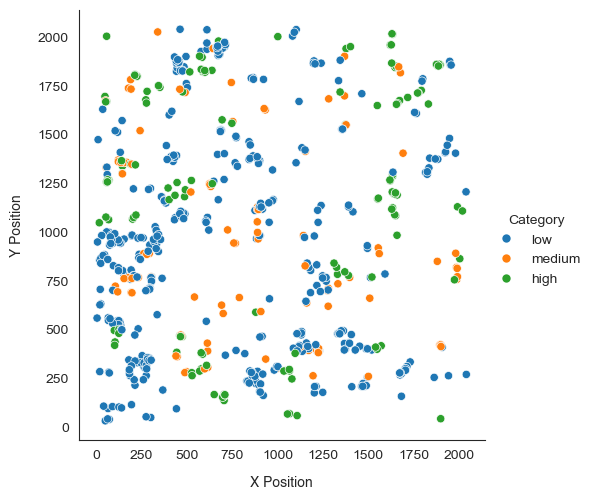

In [16]:
position_plot = sns.relplot(
                data=features_df,
                x="X", y="Y",
                hue="Category")
position_plot.set_axis_labels("X Position", "Y Position", labelpad=10, font="Helvetica")

Define function to plot scatter of particle position and colorcode based on quality

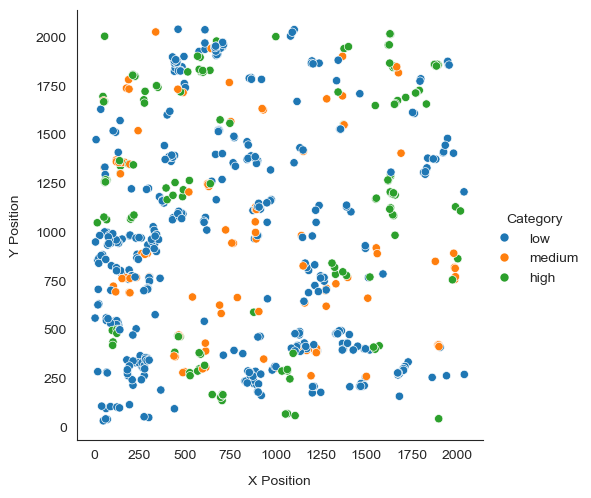

In [82]:
def position_plot(data, x="X", y="Y"):
    """function to plot scatter of particle position and colorcode based on quality"""
    sns.relplot(
                data=data,
                x="X", y="Y",
                hue="Category")
    plt.xlabel("X Position", labelpad=10)
    plt.ylabel("Y Position", labelpad=10)
    plt.show()
    return

position_plot(features_df)

Define function to plot scatter of particle position, colorcode based on quality, and zoom in to area of interest with x and y bound inputs

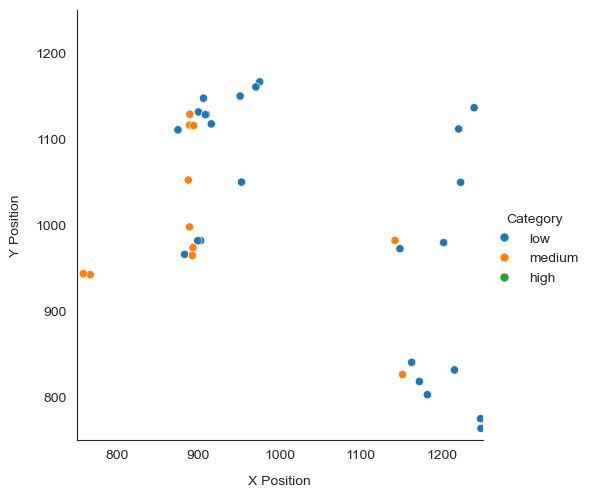

In [79]:
def zoom_position_plot(data, x="X", y="Y", x_bounds=None, y_bounds=None):
    """function to plot scatter of particle position,
    colorcode based on quality,
    and zoom in to area of interest with x and y bound inputs"""
    sns.relplot(
                data=data,
                x="X", y="Y",
                hue="Category")
    
    plt.xlabel("X Position", labelpad=10)
    plt.ylabel("Y Position", labelpad=10)
    
    if x_bounds:
        plt.xlim(x_bounds)
    if y_bounds:
        plt.ylim(y_bounds)
    
    plt.show()
    return

zoom_position_plot(features_df, x_bounds = (750, 1250), y_bounds = [750, 1250])

Plot pairwise relationships between each column

In [65]:
def pairwise_plot(data):
    """plot all pairwise plots between each column"""
    sns.pairplot(data=features_df, hue="Category")
    plt.show()
    return
pairwise_plot(features_df)

Define function to plot scatter plot of two specified features and corresponding distribution

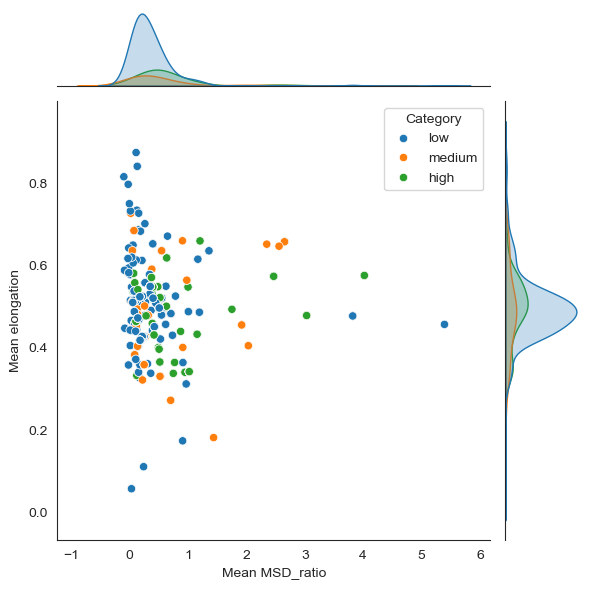

In [88]:
def pair_plot(data, x, y):
    """function to plot scatter plot of two specified features and corresponding distribution"""
    sns.jointplot(
    data=data,
    x=x, y=y,
    hue="Category")
    return

pair_plot(features_df, x="Mean MSD_ratio", y="Mean elongation")

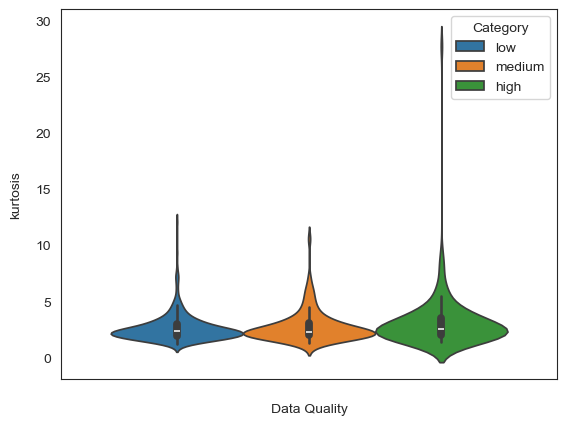

In [103]:
def violin_plot(data, x):
    """function to plot violin plot of specified column"""
    sns.violinplot(
        data=data, y=x, hue="Category")
    
    plt.xlabel("Data Quality", labelpad=10)
    plt.ylabel(x, labelpad=10)
    plt.show()
    return

violin_plot(features_df, x="kurtosis")